In [1]:
import os
from threading import Thread  # for running the denoiser in parallel
import queue

import numpy as np
import torch, gc
import torch.optim
from models.skip3D import skip  # our network

from utils.utils import *  # auxiliary functions
from utils.data import Data  # class that holds img, psnr, time
from skimage.restoration import denoise_nl_means
from torchsummary import summary
from scipy.io import loadmat
import torch.nn.functional as F
from tqdm import tqdm

In [2]:
gc.collect()
torch.cuda.empty_cache()

In [3]:
# got GPU? - if you are not getting the exact article results set CUDNN to False
CUDA_FLAG = True
CUDNN = True
if CUDA_FLAG:
    os.environ['CUDA_VISIBLE_DEVICES'] = '0'
    # GPU accelerated functionality for common operations in deep neural nets
    torch.backends.cudnn.enabled = CUDNN
    # benchmark mode is good whenever your input sizes for your network do not vary.
    # This way, cudnn will look for the optimal set of algorithms for that particular 
    # configuration (which takes some time). This usually leads to faster runtime.
    # But if your input sizes changes at each iteration, then cudnn will benchmark every
    # time a new size appears, possibly leading to worse runtime performances.
    torch.backends.cudnn.benchmark = CUDNN
    # torch.backends.cudnn.deterministic = True
    dtype = torch.cuda.FloatTensor
else:
    dtype = torch.FloatTensor

In [4]:
def get_network_and_input(img_shape, input_depth=1, pad='zero',
                          upsample_mode='trilinear', use_interpolate=True, align_corners=False,
                          act_fun='LeakyReLU', skip_n33d=[8, 16, 32, 64], 
                          skip_n33u=[8, 16, 32, 64], skip_n11= [2, 4, 8, 16],
                          num_scales=5, downsample_mode='stride', INPUT='noise'):  # 'meshgrid'
    """ Getting the relevant network and network input (based on the image shape and input depth)
        We are using the same default params as in DIP article
        img_shape - the image shape (ch, x, y)
    """
    n_channels = img_shape[0]
    net = skip(input_depth, 1,
               num_channels_down=[skip_n33d] * num_scales if isinstance(skip_n33d, int) else skip_n33d,
               num_channels_up=[skip_n33u] * num_scales if isinstance(skip_n33u, int) else skip_n33u,
               num_channels_skip=[skip_n11] * num_scales if isinstance(skip_n11, int) else skip_n11,
               upsample_mode=upsample_mode, use_interpolate=use_interpolate, align_corners=align_corners,
               downsample_mode=downsample_mode, need_sigmoid=False, need_bias=True, pad=pad, act_fun=act_fun).type(dtype)
    net_input = get_noise(n_channels, INPUT, img_shape[1:]).type(dtype).detach()
    return net, net_input

net, net_input = get_network_and_input(img_shape=(256, 256, 10), input_depth=1, num_scales=5)

In [5]:
summary(net, (1, 256, 256, 10))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv3d-1      [-1, 2, 256, 256, 10]               4
       BatchNorm3d-2      [-1, 2, 256, 256, 10]               4
         LeakyReLU-3      [-1, 2, 256, 256, 10]               0
            Conv3d-4       [-1, 8, 128, 128, 5]             224
       BatchNorm3d-5       [-1, 8, 128, 128, 5]              16
         LeakyReLU-6       [-1, 8, 128, 128, 5]               0
            Conv3d-7       [-1, 8, 128, 128, 5]           1,736
       BatchNorm3d-8       [-1, 8, 128, 128, 5]              16
         LeakyReLU-9       [-1, 8, 128, 128, 5]               0
           Conv3d-10       [-1, 4, 128, 128, 5]              36
      BatchNorm3d-11       [-1, 4, 128, 128, 5]               8
        LeakyReLU-12       [-1, 4, 128, 128, 5]               0
           Conv3d-13        [-1, 16, 64, 64, 3]           3,472
      BatchNorm3d-14        [-1, 16, 64

In [6]:
def plot_object(data_dict):
    for key, data in data_dict.items():
        plt.rcParams['figure.figsize'] = [8*4, 80*4]
        fig = plt.figure()
        fig.subplots_adjust(hspace=.15, wspace=.15)
        num_plot = np.shape(data.img)[-1]
        for j in range(num_plot):
            ax = fig.add_subplot(1, num_plot, j + 1)
            plt.imshow(data.img[:, :, j])
            ax.axes.xaxis.set_ticks([])
            ax.axes.yaxis.set_ticks([])
        ax.text(-2.55, -0.25, key + (" psnr: %.2f" % (data.psnr) if data.psnr is not None else ""),
                size=30, ha="center", transform=ax.transAxes)
    plt.clim(0, 1)
    plt.show()

In [7]:
def load_object(plot=False):
    """ 
        Return a numpy image, and a noisy numpy image
    """
    img_np = loadmat('./FBP-256/FDK-1.mat')['Reconimg'][:, :, :]
    img_noisy_np = loadmat('./FBP-256/FDK-' + str(2**(SKIP-1)) + '.mat')['Reconimg'][:, :, :]
    
    img_np = np.clip(img_np, 0, 1)
    img_noisy_np = np.clip(img_noisy_np, 0, 1)
    #print(np.shape(img_np))
    #print(np.max(img_np), np.min(img_np))
    #print(np.max(img_noisy_np), np.min(img_noisy_np))
    data_dict = {ORIGINAL: Data(img_np), CORRUPTED: Data(img_noisy_np, compare_psnr(img_np, img_noisy_np))}
    if plot:
        plot_object(data_dict)
    return data_dict

In [8]:
# using GPU?
GPU = True

# define number of object voxels
nx, ny, nz = 256, 256, 10

# object real size in mm
sx, sy, sz = 5, 5, 0.1

# real detector pixel density
nu, nv = 254, 10

# detector real size in mm
su, sv = 5, 0.2

# single voxel size
dx, dy, dz, du, dv = sx/nx, sy/ny, sz/nz, su/nu, sv/nv

# Geometry calculation
xs = torch.arange(-(nx -1) / 2, nx / 2, 1) * dx
ys = torch.arange(-(ny -1) / 2, ny / 2, 1) * dy
zs = torch.arange(-(nz -1) / 2, nz / 2, 1) * dz

us = torch.arange(-(nu -1) / 2, nu / 2, 1) * du
vs = torch.arange(-(nv -1) / 2, nv / 2, 1) * dv

# source to detector, and source to object axis distances in mm
DSD, DSO = 74.11, 55.07

In [9]:
SIGMA = 25
# graphs labels:
X_LABELS = ['Iterations']*3
Y_LABELS = ['PSNR between x and net (db)', 'PSNR with original image (db)', 'loss']

# Algorithm NAMES (to get the relevant image: use data_dict[alg_name].img)
# for example use data_dict['Clean'].img to get the clean image
ORIGINAL = 'Clean'
CORRUPTED = 'Noisy'
NLM = 'NLM'
DIP_NLM = 'DRED (NLM)'

In [10]:
def Projection2D_batch(data3d, batch_size=100):
    """
    Genearting 2D projections from cone beam geometry with batching in the angles
    data3d in shape of nz, nx, ny
    """
    # to store multi-angle projections
    proj_tot = []
    
    data3d.requires_grad_()
    
    # batching for the angle
    for i in range(nProj // batch_size + 1):
        # genearting affine grids for sample rotation
        angle_rad = deg[i * batch_size:(i+1) * batch_size] / 360 * 2 * np.pi
        angle_rad = angle_rad.unsqueeze(-1).unsqueeze(-1)

        uu, vv = torch.meshgrid(us, vs)
        uu, vv = uu.T, vv.T
        xx, yy = torch.meshgrid(xs, ys)
        xx, yy = xx.T, yy.T

        rx = (xx * torch.cos(angle_rad) - yy * torch.sin(angle_rad)) / dx / nx * 2
        ry = (xx * torch.sin(angle_rad) + yy * torch.cos(angle_rad)) / dy / ny * 2

        if GPU:
            rx = rx.to(device='cuda:0')
            ry = ry.to(device='cuda:0')

        # rxry in (batch, rx, ry, 2)
        rxry = torch.stack((rx, ry), -1)

        # using bilinear interpolation to sample the rotated objects
        # expand the data3d in the batch dimension without consuming GPU memory
        # data3d_new in shape of (batch, nz, nx, ny)
        data3d_new = F.grid_sample(data3d.unsqueeze(0).expand(len(angle_rad), nz, nx, ny), rxry, 
                           mode='bilinear', padding_mode='zeros', align_corners=True)

        # generate sampling grid in xs and zs for cone beam
        xx, zz = torch.meshgrid(xs, zs)
        xx, zz = xx.T, zz.T

        Ratio = (ys + DSO) / DSD
        # to do broadcasting later on
        Ratio = Ratio.unsqueeze(-1).unsqueeze(-1)

        pu, pv = uu * Ratio, vv * Ratio
        pu, pv = (pu) / dx / nx * 2, (pv) / dz / nz * 2
        pu, pv = pu.to(torch.float32), pv.to(torch.float32)

        if GPU:
            pv = pv.to(device='cuda:0')
            pu = pu.to(device='cuda:0')

        # pupv in (ny, nu, nv, 2)
        pupv = torch.stack((pu, pv), -1)

        # permute data3d from (batch, nz, nx, ny) to (ny, batch, nz, nx)
        # to process all the ny elements
        data3d_new = data3d_new.permute(3, 0, 1, 2)
        temp = F.grid_sample(data3d_new, pupv, 
                             mode='bilinear', padding_mode='zeros', align_corners=True)

        # sum in ny to produce the 2d projections
        # then transpose to  (batch, nx, nz)
        proj2d = torch.sum(temp, dim=[0])
        proj2d = proj2d.permute(0, 2, 1)

        dist = torch.sqrt(DSD**2 + uu**2 + vv**2) / DSD * dy

        if GPU:
            dist = dist.to(device='cuda:0')
        # multiple the distance matrix
        proj2d = proj2d * dist.T
        
        proj_tot.append(proj2d)
    # concat alone the batch dimension to get all the projections
    proj_tot = torch.cat(proj_tot, dim=0)

    return proj_tot

In [11]:
def train_via_admm(net, net_input, y, org_img=None,
                   plot_array={}, algorithm_name="", admm_iter=5000, save_path="",
                   LR=0.01, reg_noise_std = 0.05):
    """ training the network using
        ## Must Params ##
        net                 - the network to be trained
        net_input           - the network input
        y                   - the noisy image
        sigma               - the noise level (int 0-255)
        
        # optional params #
        org_img             - the original image if exist for psnr compare only, or None (default)
        plot_array          - prints params at the begging of the training and plot images at the required indices
        LR                  - the lr of the network
    """
    # get optimizer and loss function:
    mse = torch.nn.MSELoss().type(dtype)  # using MSE loss
    # additional noise added to the input:
    net_input_saved = net_input.detach().clone()
    noise = net_input.detach().clone()
    
    if org_img is not None:
        psnr_y = compare_psnr(org_img, y)  # get the noisy image psnr
    
    # optimizer and scheduler
    optimizer = torch.optim.Adam(net.parameters(), lr=LR)  # using ADAM opt
    
    # load data
    projections = loadmat('projections.mat')['projections']
    projections = np.transpose(projections, (0, 2, 1))
    projections = projections[::2**(SKIP-1), :, :]
    batch_size = np.shape(projections)[0]
    projections = np_to_torch(projections).type(dtype)
    
    avg = np.rint(y)
    
    out_save = []
    loss_save = []
    
    y_out = torch.from_numpy(y).unsqueeze(0).type(dtype)
    
    for i in range(1, 1 + admm_iter):
        # step 1, update network:
        optimizer.zero_grad()
        
        if reg_noise_std > 0:
            net_input = net_input_saved + (noise.normal_() * reg_noise_std)
            net_input = net_input.unsqueeze(0)
            
        out = net(net_input)
        out = out + y_out
        out = torch.nn.Sigmoid()(out)
        out = out[0, :, :, :]
        
        out_crop = out[0].permute(2, 0, 1)
        out_np = torch_to_np(out)
        
        projected = Projection2D_batch(out_crop, batch_size=batch_size)
        
        # loss:
        #print(np.shape(projected), np.shape(projections))
        loss_y = mse(projected, projections[0])
        total_loss = loss_y
        total_loss.backward()
        optimizer.step()
        
        if i % 100 == 0:
            out_save.append(out_np)
            loss_save.append(total_loss.detach().cpu().numpy())
        
        # Averaging:
        avg = avg * .99 + out_np * .01
        # show psnrs:
        psnr_noisy = compare_psnr(out_np, y)

        if org_img is not None:
            psnr_net, psnr_avg = compare_psnr(org_img, out_np), compare_psnr(org_img, avg)
            psnr_x, psnr_x_u = 0, 0
            print('\r', algorithm_name, '%04d/%04d Loss %f' % (i, admm_iter, total_loss.item()),
                  'psnrs: y: %.2f psnr_noisy: %.2f net: %.2f' % (psnr_y, psnr_noisy, psnr_net),
                  'x: %.2f x-u: %.2f avg: %.2f' % (psnr_x, psnr_x_u, psnr_avg), end='')
            if i in plot_array:  # plot images
                tmp_dict = {'Clean': Data(org_img),
                            'Noisy': Data(y, psnr_y),
                            'Net': Data(out_np, psnr_net),
                            #'x-u': Data(x - u, psnr_x_u),
                            'avg': Data(avg, psnr_avg),
                            #'x': Data(x, psnr_x),
                            #'u': Data((u - np.min(u)) / (np.max(u) - np.min(u)))
                            }
                plot_object(tmp_dict)
        else:
            print('\r', algorithm_name, 'iteration %04d/%04d Loss %f' % (i, admm_iter, total_loss.item()), end='')
    
    out_save.append(avg)
    np.save('recon-ver2-' + str(SKIP) + '.npy', out_save)
    np.save('loss-ver2-' + str(SKIP) + '.npy', loss_save)
    
    return avg

In [12]:
def init_weights(m):
    if isinstance(m, torch.nn.Conv3d):
        m.weight.data.normal_(0.0, 0.02)
        m.bias.data.fill_(0.01)
        #print(m.weight)
    elif isinstance(m, torch.nn.BatchNorm3d):
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0.01)

def run_and_plot(name, plot_checkpoints={}):
    global data_dict
    net, net_input = get_network_and_input(img_shape=data_dict[CORRUPTED].img.shape, input_depth=1, num_scales=3)
    print(np.shape(net_input))
    net.apply(init_weights)
    #net_input = torch.from_numpy(data_dict[CORRUPTED].img).unsqueeze(0)
    denoised_img = train_via_admm(net, net_input, data_dict[CORRUPTED].img,
                                  plot_array=plot_checkpoints, algorithm_name=name,
                                  org_img=data_dict[ORIGINAL].img)
    data_dict[name] = Data(denoised_img, compare_psnr(data_dict[ORIGINAL].img, denoised_img))
    plot_object(data_dict)

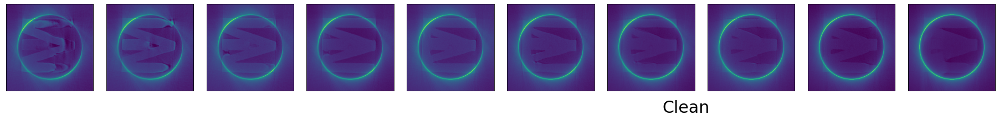

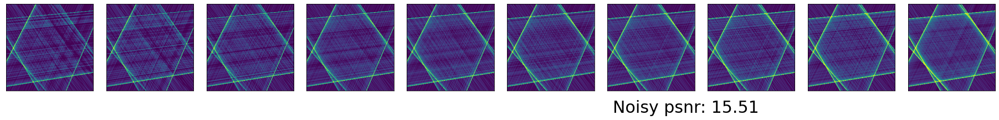

torch.Size([1, 256, 256, 10])
 DRED (NLM) 0001/5000 Loss 3.799718 psnrs: y: 15.51 psnr_noisy: 7.72 net: 7.52 x: 0.00 x-u: 0.00 avg: 13.30

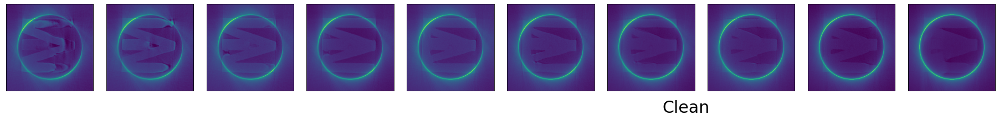

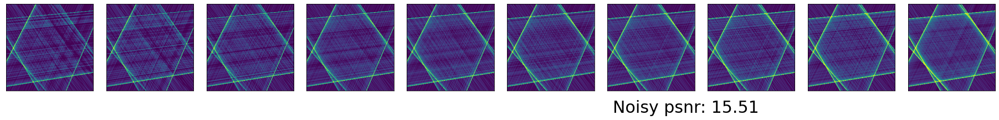

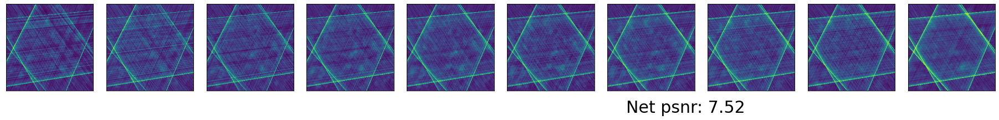

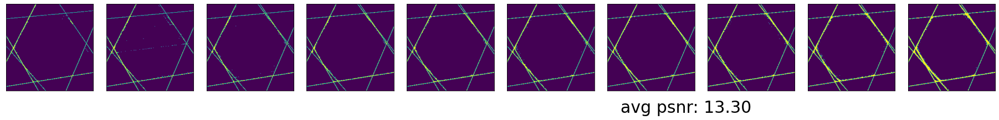

 DRED (NLM) 0010/5000 Loss 2.134279 psnrs: y: 15.51 psnr_noisy: 9.45 net: 9.34 x: 0.00 x-u: 0.00 avg: 14.38

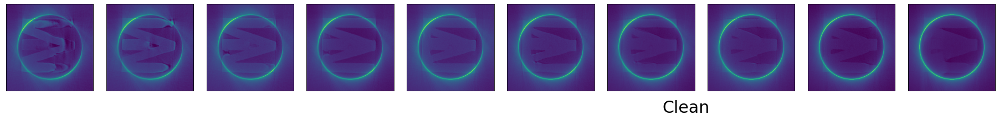

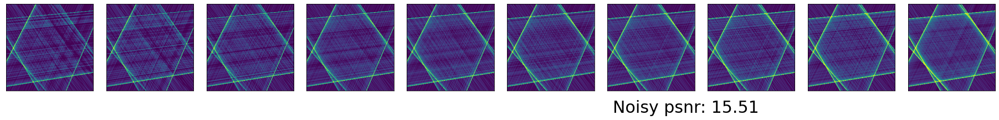

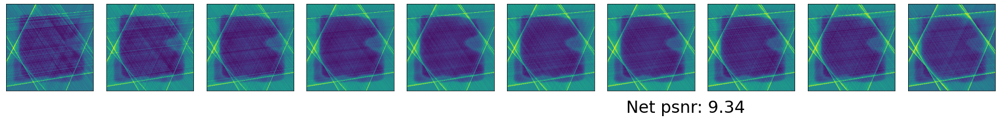

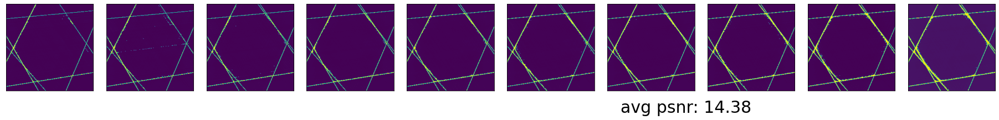

 DRED (NLM) 0050/5000 Loss 0.052500 psnrs: y: 15.51 psnr_noisy: 9.87 net: 11.12 x: 0.00 x-u: 0.00 avg: 16.083

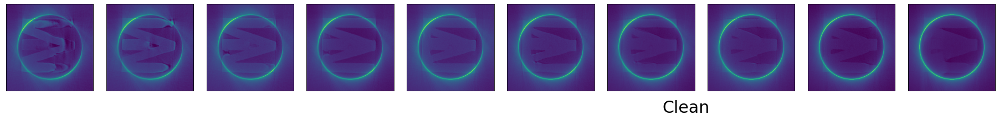

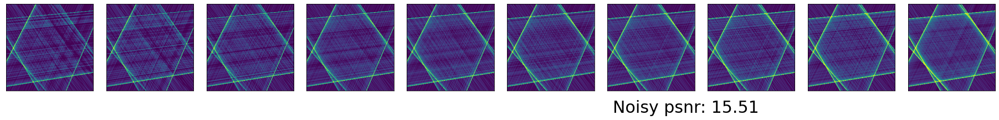

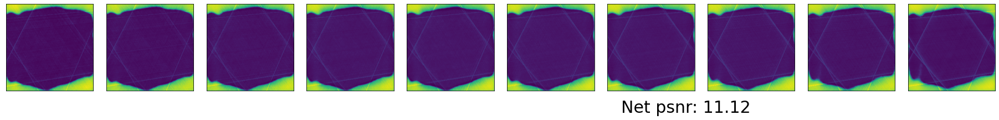

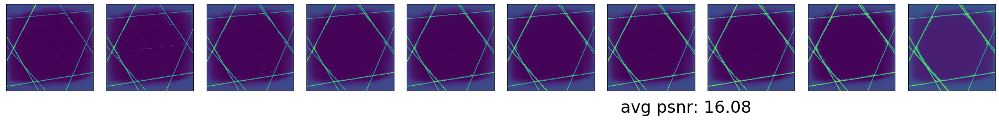

 DRED (NLM) 0100/5000 Loss 0.036334 psnrs: y: 15.51 psnr_noisy: 10.54 net: 12.12 x: 0.00 x-u: 0.00 avg: 15.62

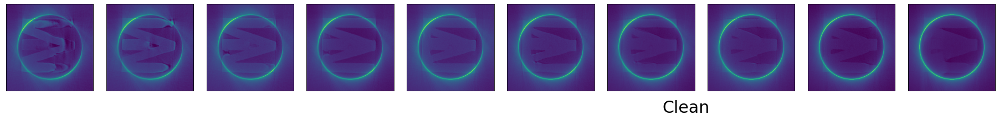

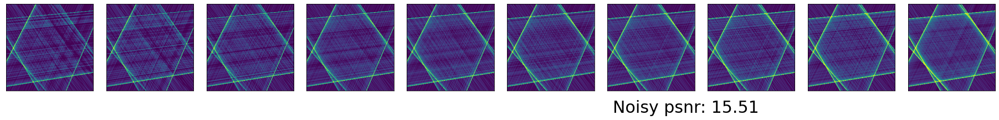

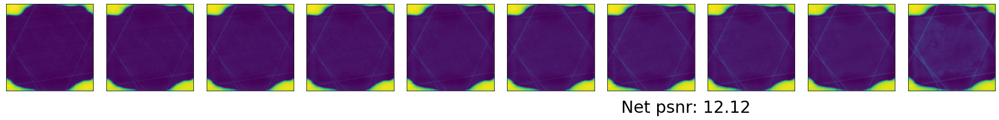

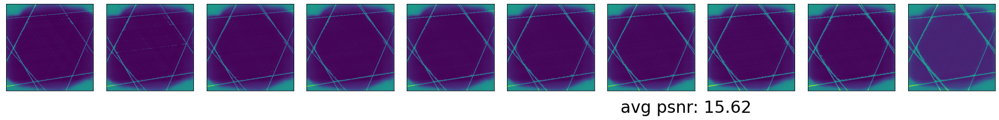

 DRED (NLM) 0250/5000 Loss 0.035648 psnrs: y: 15.51 psnr_noisy: 10.51 net: 12.17 x: 0.00 x-u: 0.00 avg: 13.29

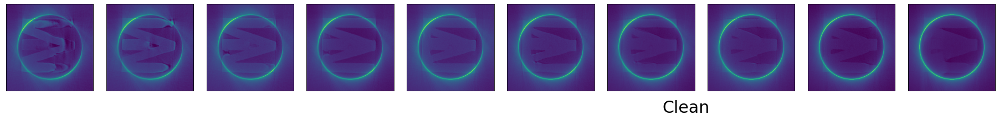

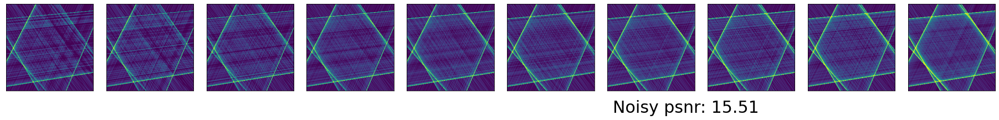

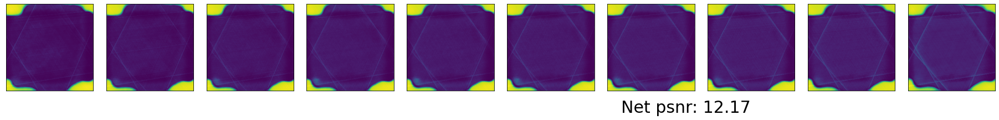

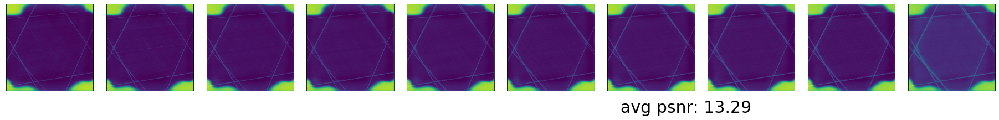

 DRED (NLM) 0500/5000 Loss 0.034945 psnrs: y: 15.51 psnr_noisy: 10.76 net: 12.54 x: 0.00 x-u: 0.00 avg: 12.63

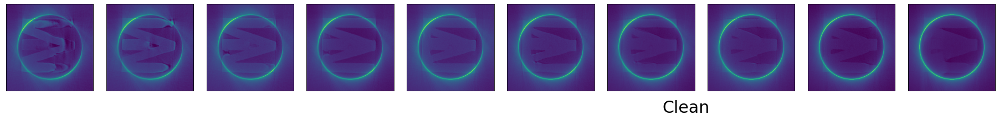

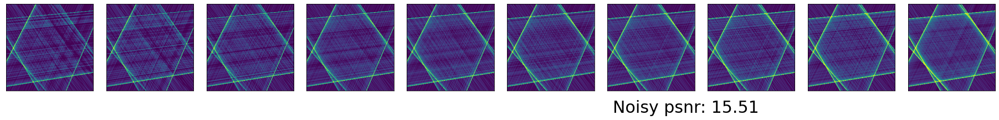

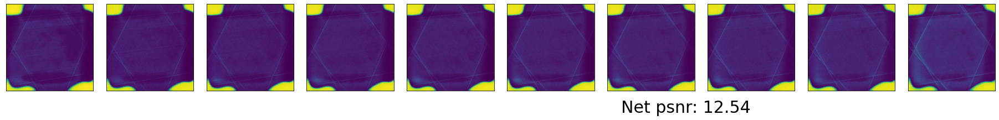

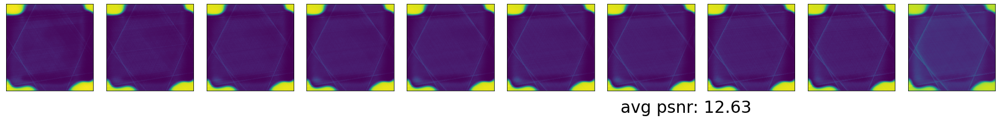

 DRED (NLM) 0999/5000 Loss 0.034496 psnrs: y: 15.51 psnr_noisy: 10.67 net: 12.52 x: 0.00 x-u: 0.00 avg: 12.631000/5000 Loss 0.034522 psnrs: y: 15.51 psnr_noisy: 10.71 net: 12.54 x: 0.00 x-u: 0.00 avg: 12.62

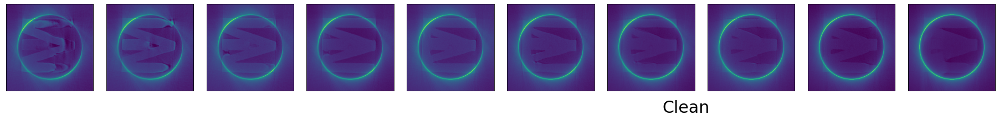

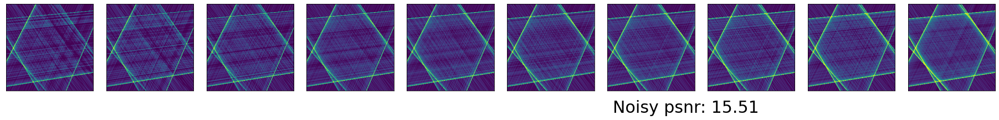

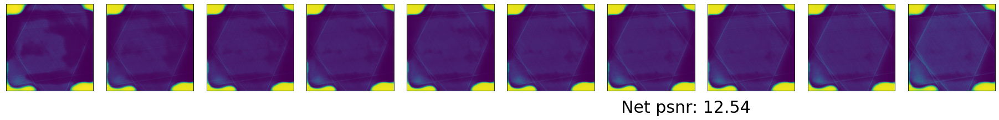

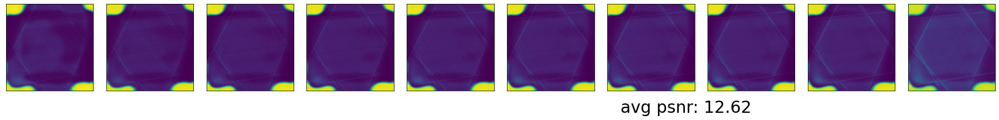

 DRED (NLM) 2000/5000 Loss 0.034213 psnrs: y: 15.51 psnr_noisy: 10.65 net: 12.49 x: 0.00 x-u: 0.00 avg: 12.59

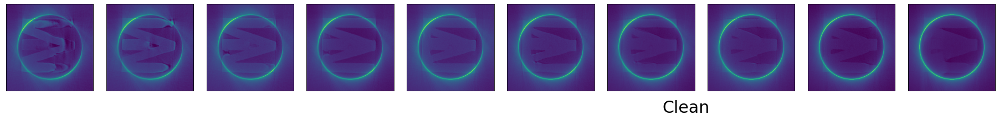

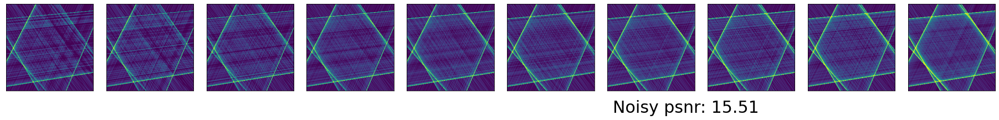

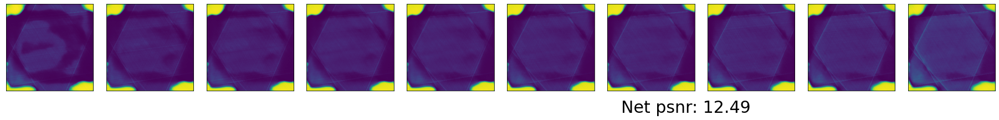

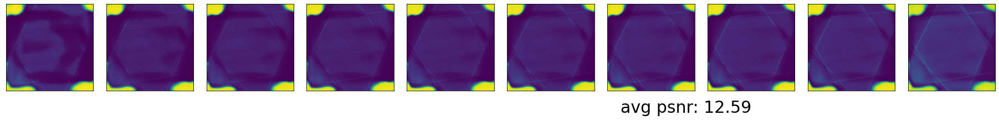

 DRED (NLM) 4000/5000 Loss 0.034067 psnrs: y: 15.51 psnr_noisy: 10.66 net: 12.53 x: 0.00 x-u: 0.00 avg: 12.563445/5000 Loss 0.034094 psnrs: y: 15.51 psnr_noisy: 10.67 net: 12.52 x: 0.00 x-u: 0.00 avg: 12.61

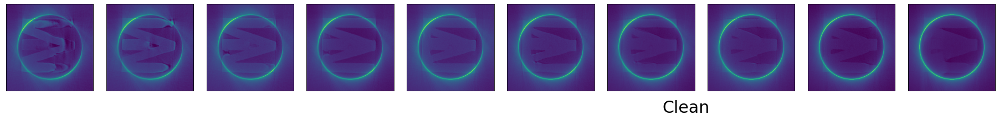

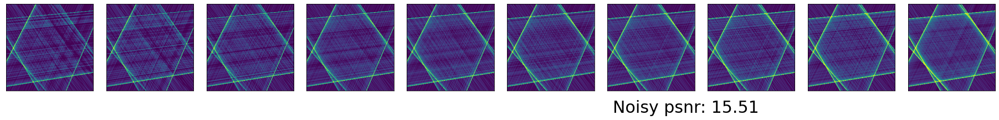

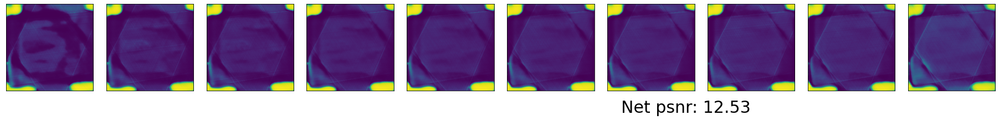

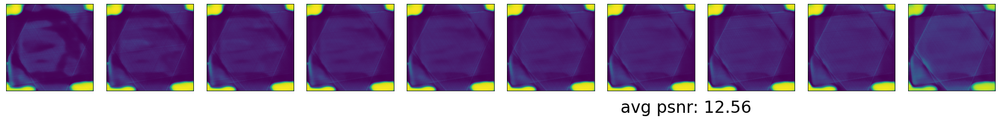

 DRED (NLM) 5000/5000 Loss 0.034013 psnrs: y: 15.51 psnr_noisy: 10.63 net: 12.49 x: 0.00 x-u: 0.00 avg: 12.52

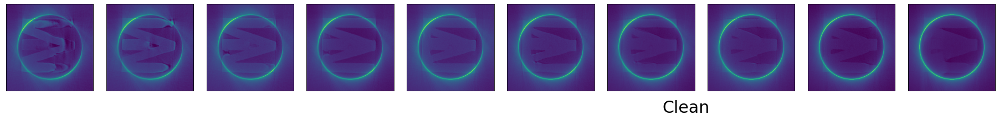

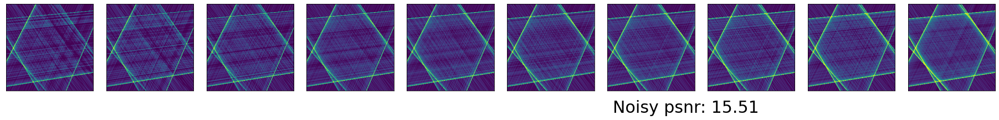

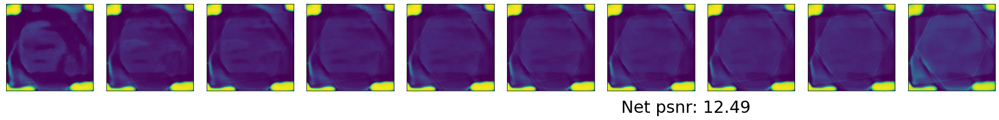

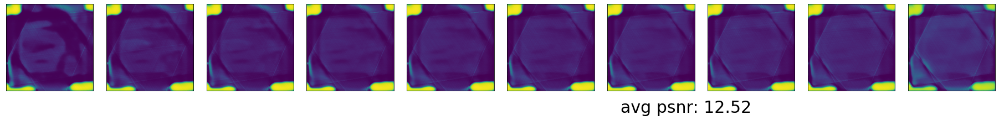

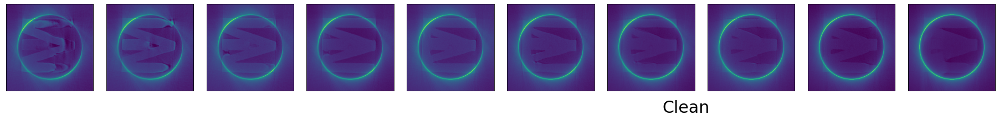

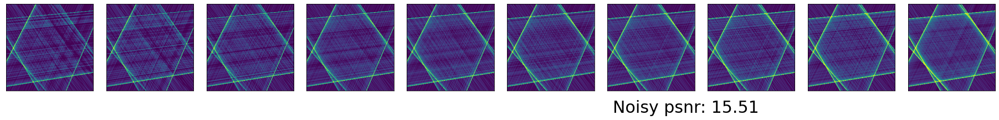

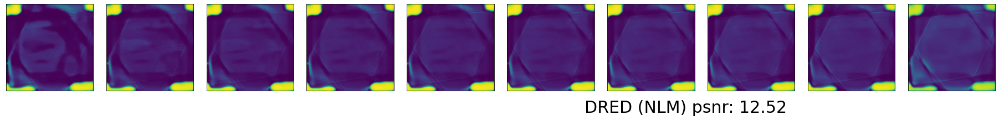

In [14]:
for SKIP in range(9, 10):
    #SKIP = 6
    direction = 1 # clock wise/ counter clockwise
    start = 0.
    end = 360.
    step = 0.225 * 2**(SKIP-1)
    deg = direction * torch.arange(start, end+0.225, step)
    nProj = len(deg)
    
    data_dict = load_object(plot=True)

    plot_checkpoints = {1, 10, 50, 100, 250, 500, 1000, 2000, 4000, 5000} 
    run_and_plot(DIP_NLM, plot_checkpoints)  # you may try it with different denoisers